# 02 FLUX Schnell Endpoint Testing

Notebook contains logic to retrieve credentials for newly created online endpoint and submit a small number of image generation requests to verify operation

### Import required packages and establish connection to AML workspace

In [ ]:
from azure.ai.ml import MLClient
from azure.identity import DefaultAzureCredential
import requests
import json
from IPython.display import Image, display, Markdown, HTML
import time

subscription_id = "<YOUR-SUBSCRIPTION-ID>"
resource_group = "<YOUR-RESOURCE-GROUP>"
workspace = "<YOUR-AML-WORKSPACE-NAME>"
model_name = "flux-schnell"

ml_client = MLClient(DefaultAzureCredential(), subscription_id, resource_group, workspace)
ml_client

### Retrieve scoring uri and API key for the endpoint

In [29]:
scoring_uri = ml_client.online_endpoints.get('flux-schnell-endpoint').scoring_uri
api_key = ml_client.online_endpoints.get_keys('flux-schnell-endpoint').primary_key

### Define test prompts

In [34]:
prompts = [
    "A futuristic city skyline at night, with towering skyscrapers and flying cars, under a vibrant aurora borealis.",
    "A serene beach at sunset, with waves gently lapping the shore and a silhouette of a lone surfer.",
    "A detailed close-up of a mechanical watch with intricate gears and a transparent casing, showing the inner workings.",
    "A mythical dragon soaring over a dense forest, breathing fire, with the moon visible in the background.",
    "A bustling medieval marketplace, with merchants selling goods, children playing, and a castle in the distance.",
    "A cozy reading nook by a large window, filled with books, soft pillows, and a view of a rainy day outside.",
    "An abstract representation of time, with melting clocks, spirals, and a distorted landscape in the background.",
    "A portrait of a 19th-century aristocrat in formal attire, standing in an ornate room with classic decor.",
    "A whimsical underwater scene with colorful coral reefs, schools of fish, and a friendly octopus wearing a top hat.",
    "A post-apocalyptic landscape with crumbling buildings, overgrown vegetation, and a lone figure walking towards the horizon."
]

### Test the endpoint

Iterate over all prompts and display output images returned from the model

### Prompt: "A futuristic city skyline at night, with towering skyscrapers and flying cars, under a vibrant aurora borealis."

Inferencing Time: 2.83s


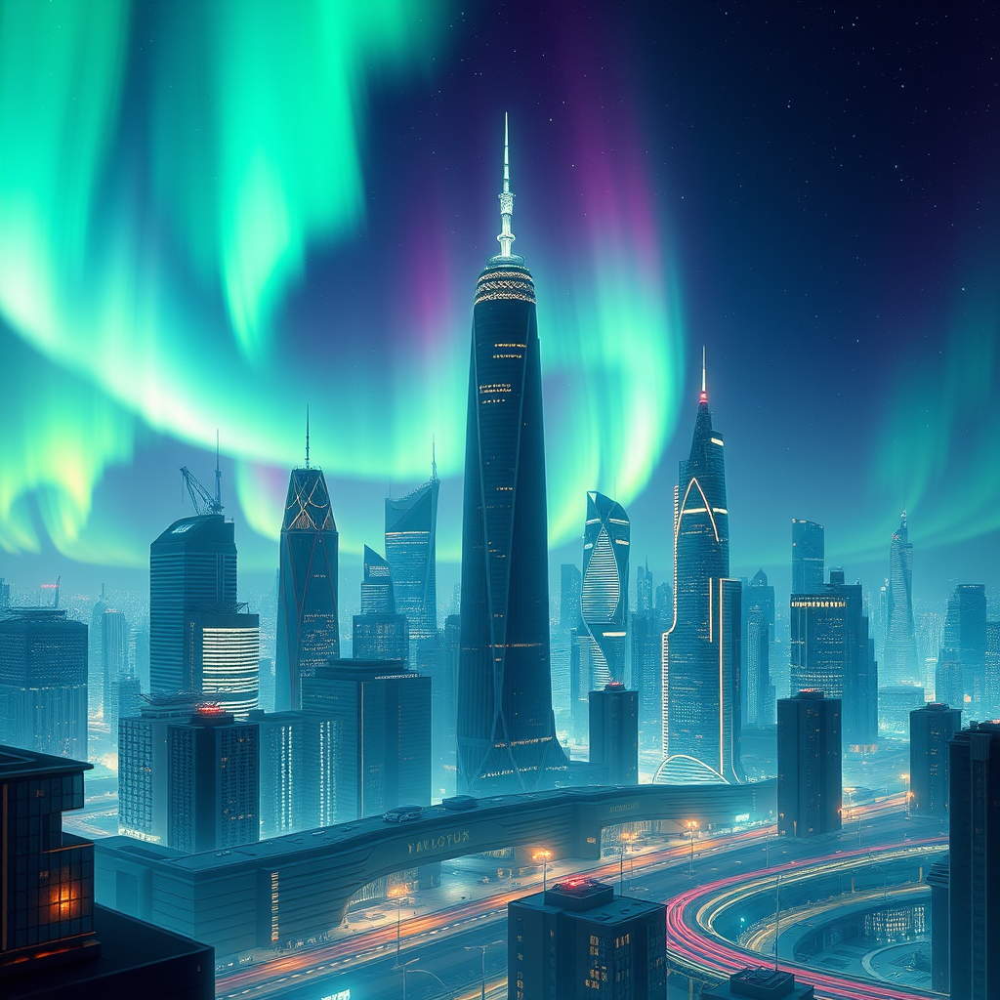

### Prompt: "A serene beach at sunset, with waves gently lapping the shore and a silhouette of a lone surfer."

Inferencing Time: 2.82s


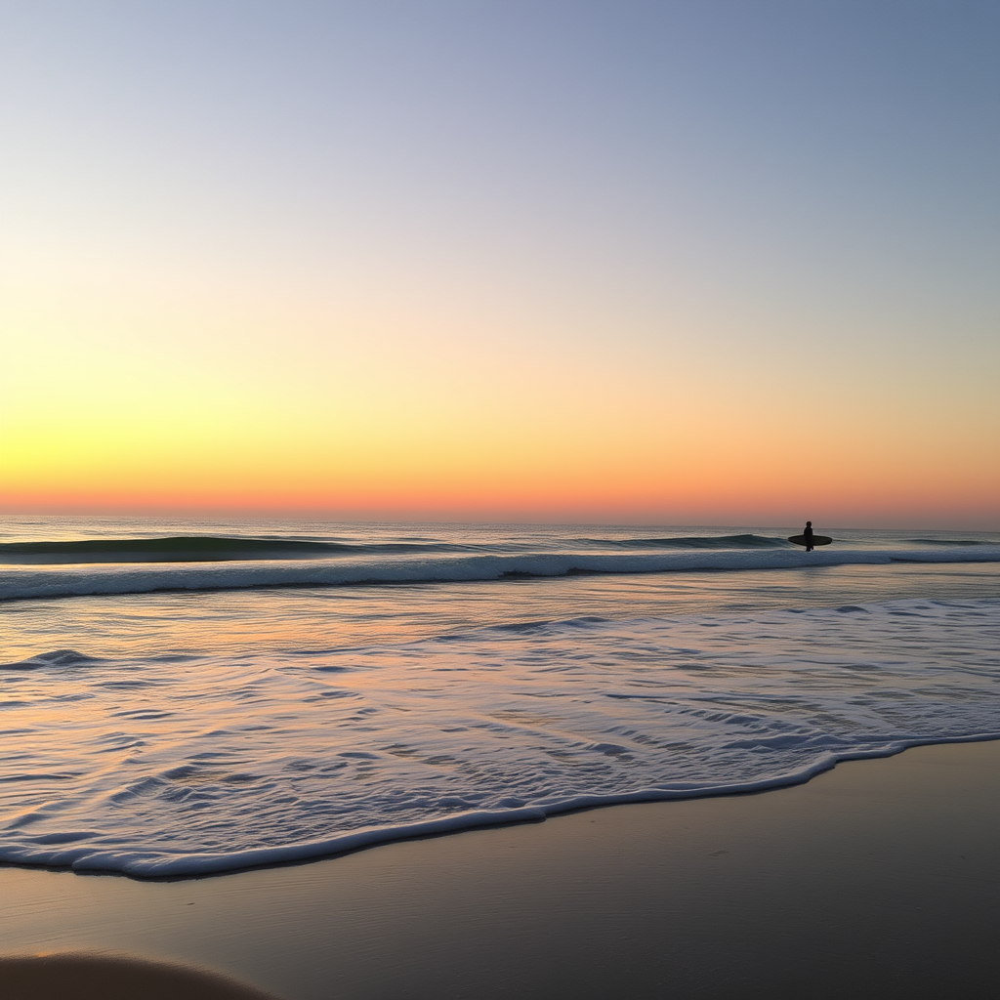

### Prompt: "A detailed close-up of a mechanical watch with intricate gears and a transparent casing, showing the inner workings."

Inferencing Time: 2.85s


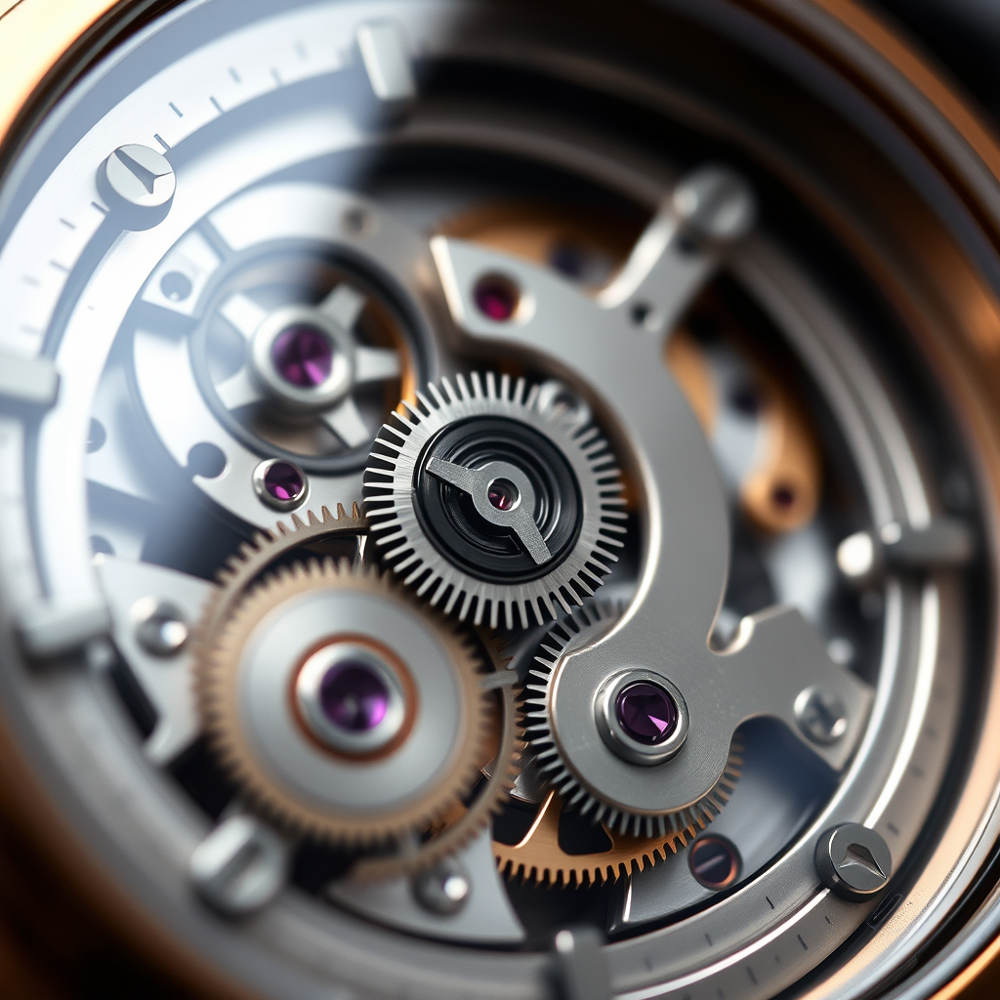

### Prompt: "A mythical dragon soaring over a dense forest, breathing fire, with the moon visible in the background."

Inferencing Time: 2.82s


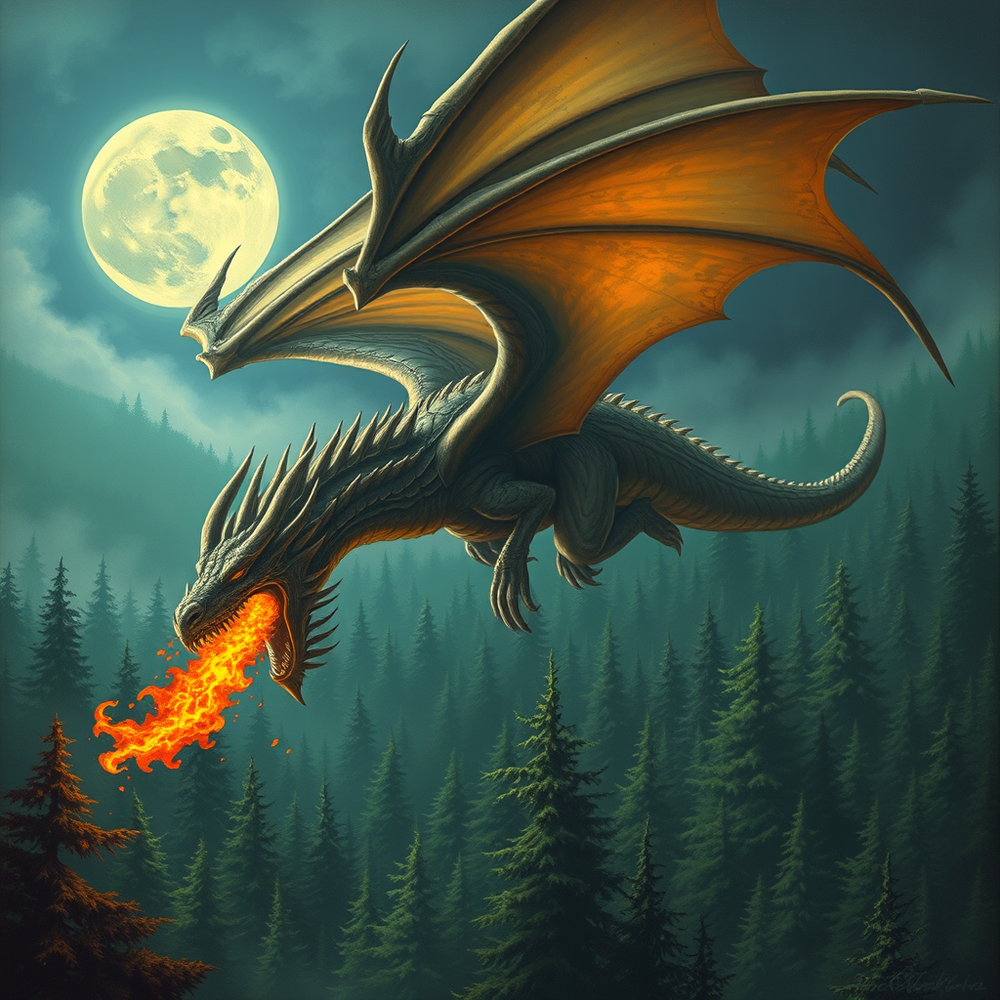

### Prompt: "A bustling medieval marketplace, with merchants selling goods, children playing, and a castle in the distance."

Inferencing Time: 2.73s


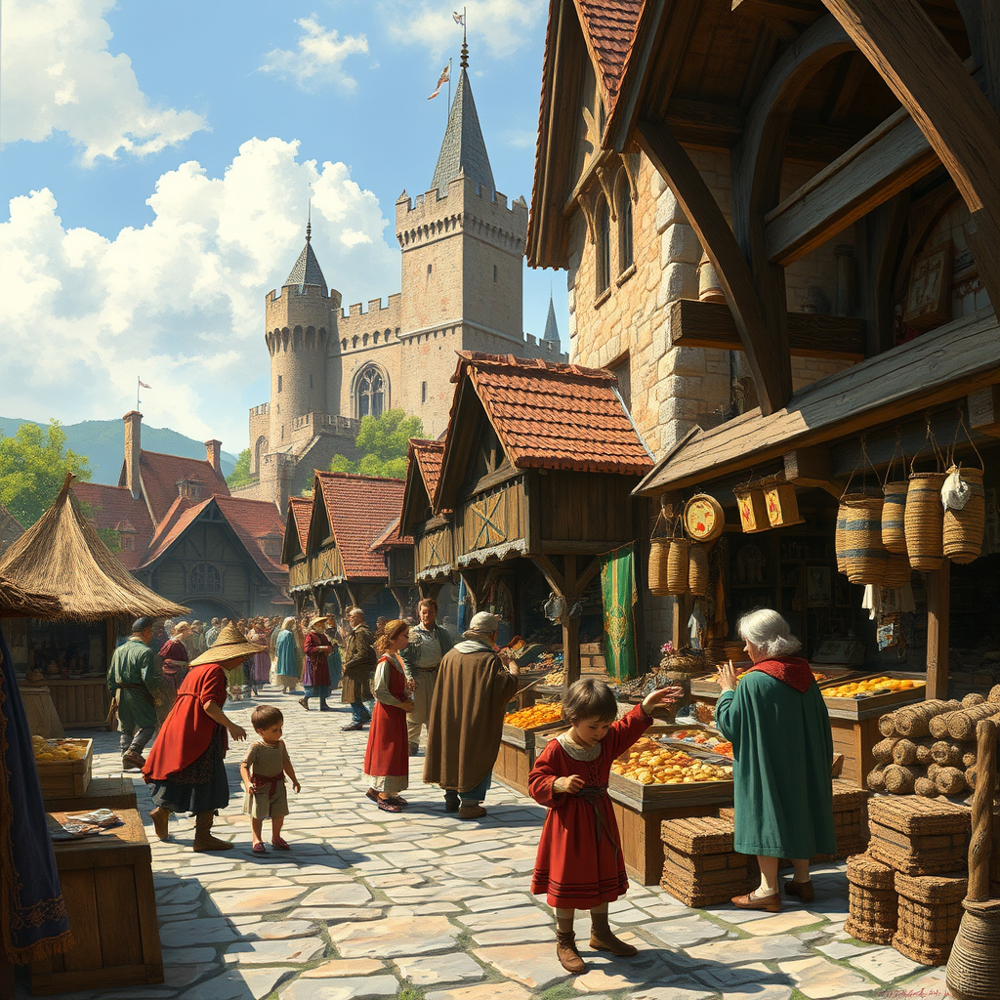

### Prompt: "A cozy reading nook by a large window, filled with books, soft pillows, and a view of a rainy day outside."

Inferencing Time: 2.69s


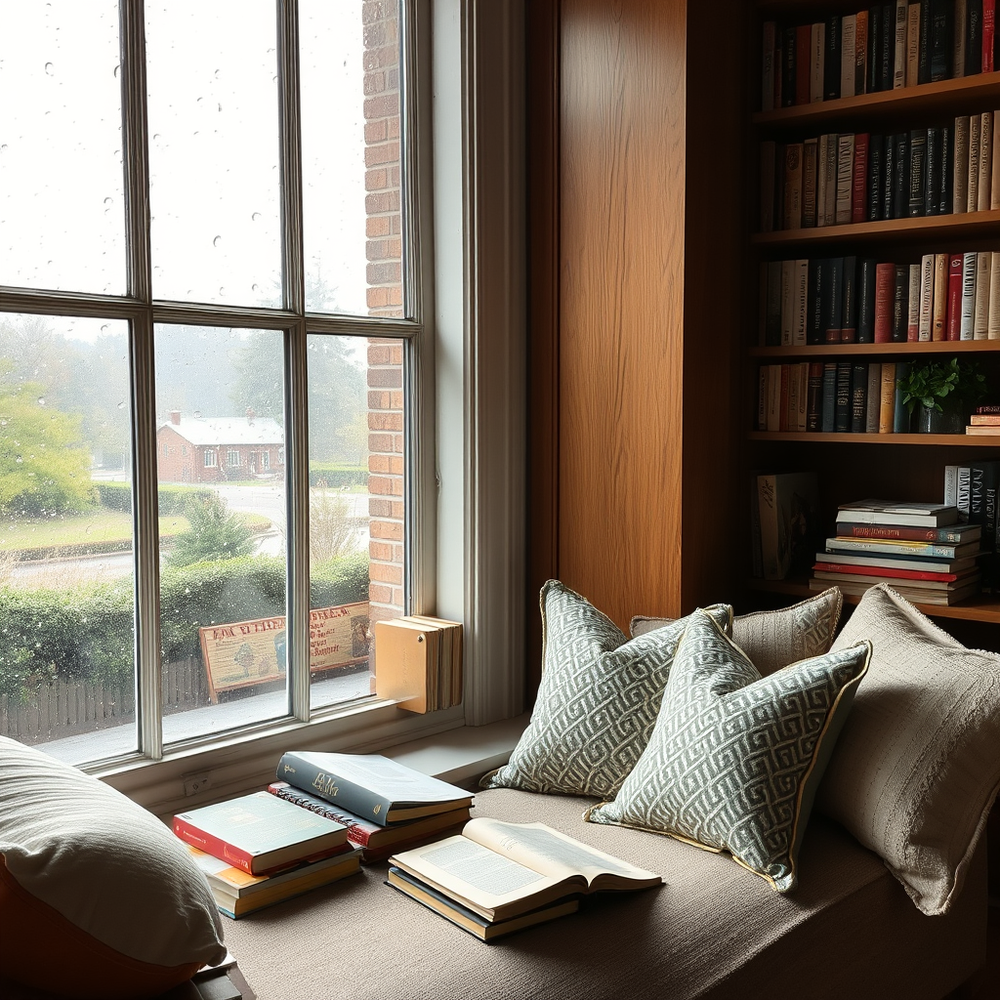

### Prompt: "An abstract representation of time, with melting clocks, spirals, and a distorted landscape in the background."

Inferencing Time: 2.62s


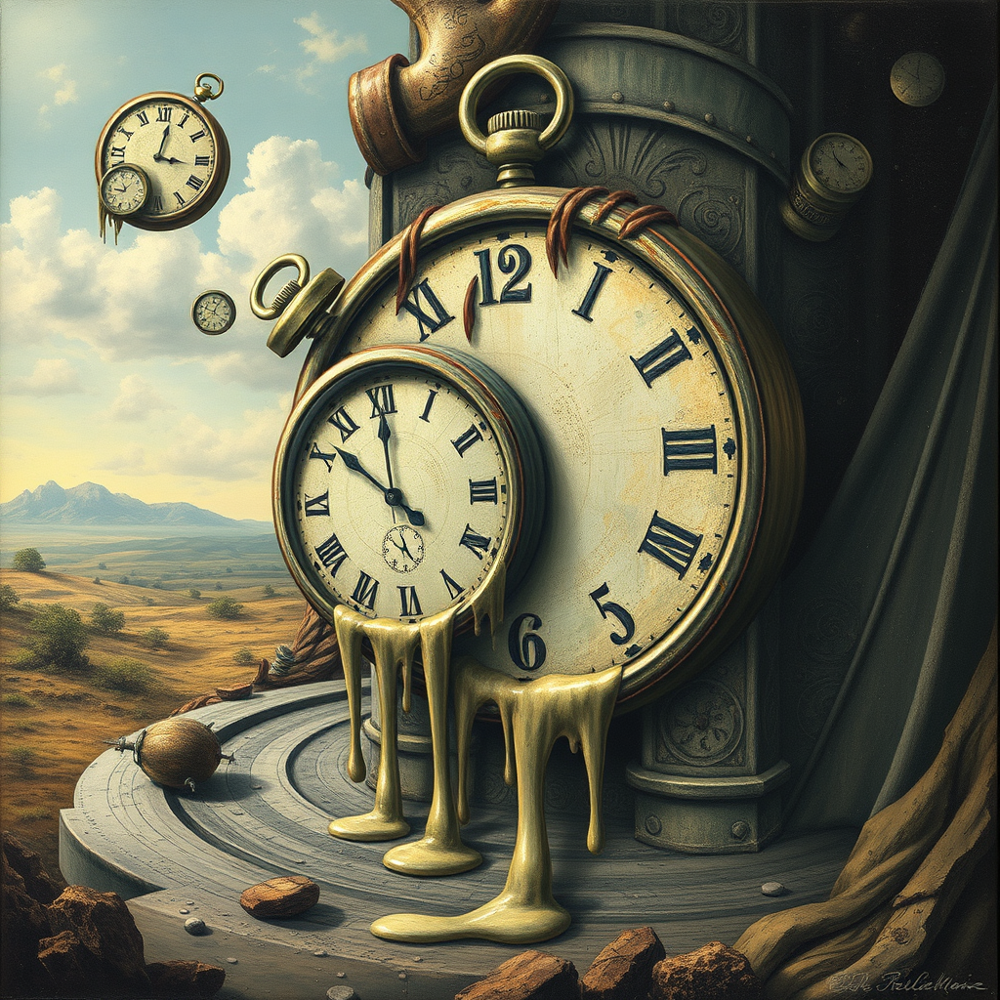

### Prompt: "A portrait of a 19th-century aristocrat in formal attire, standing in an ornate room with classic decor."

Inferencing Time: 2.8s


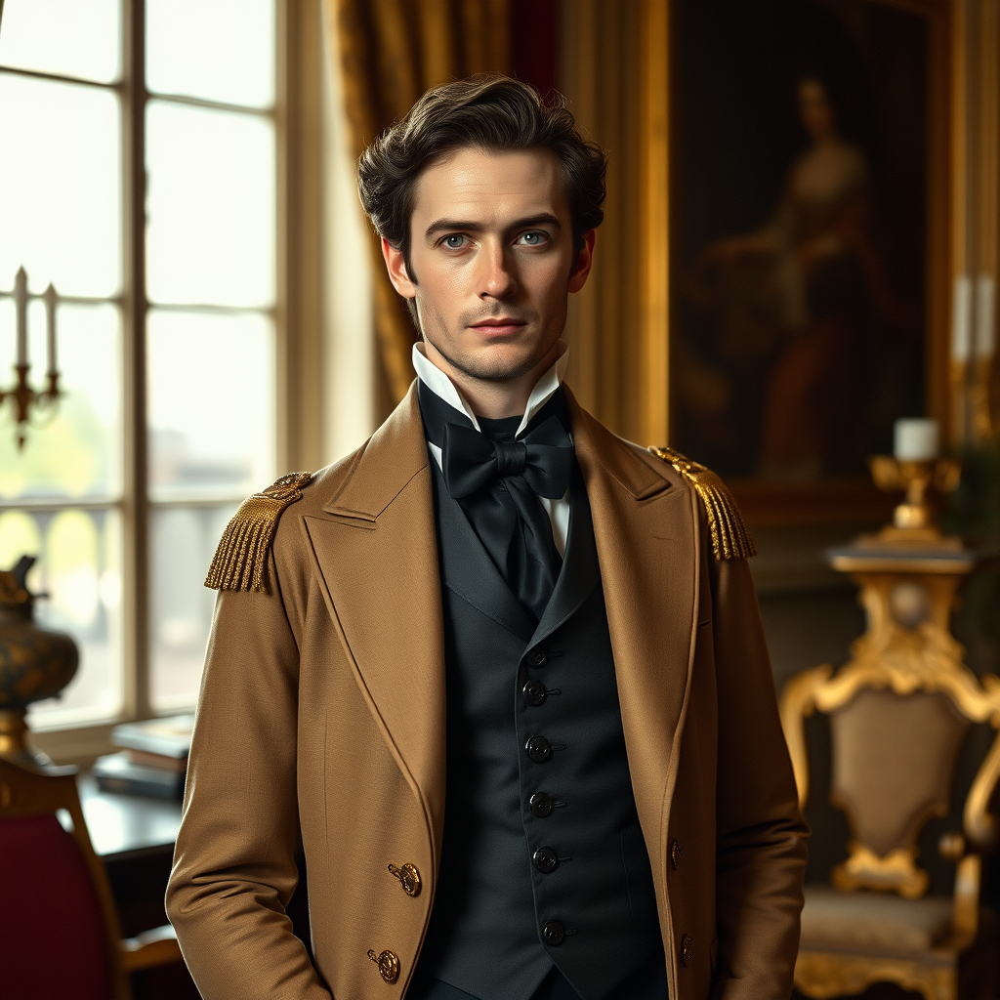

### Prompt: "A whimsical underwater scene with colorful coral reefs, schools of fish, and a friendly octopus wearing a top hat."

Inferencing Time: 2.66s


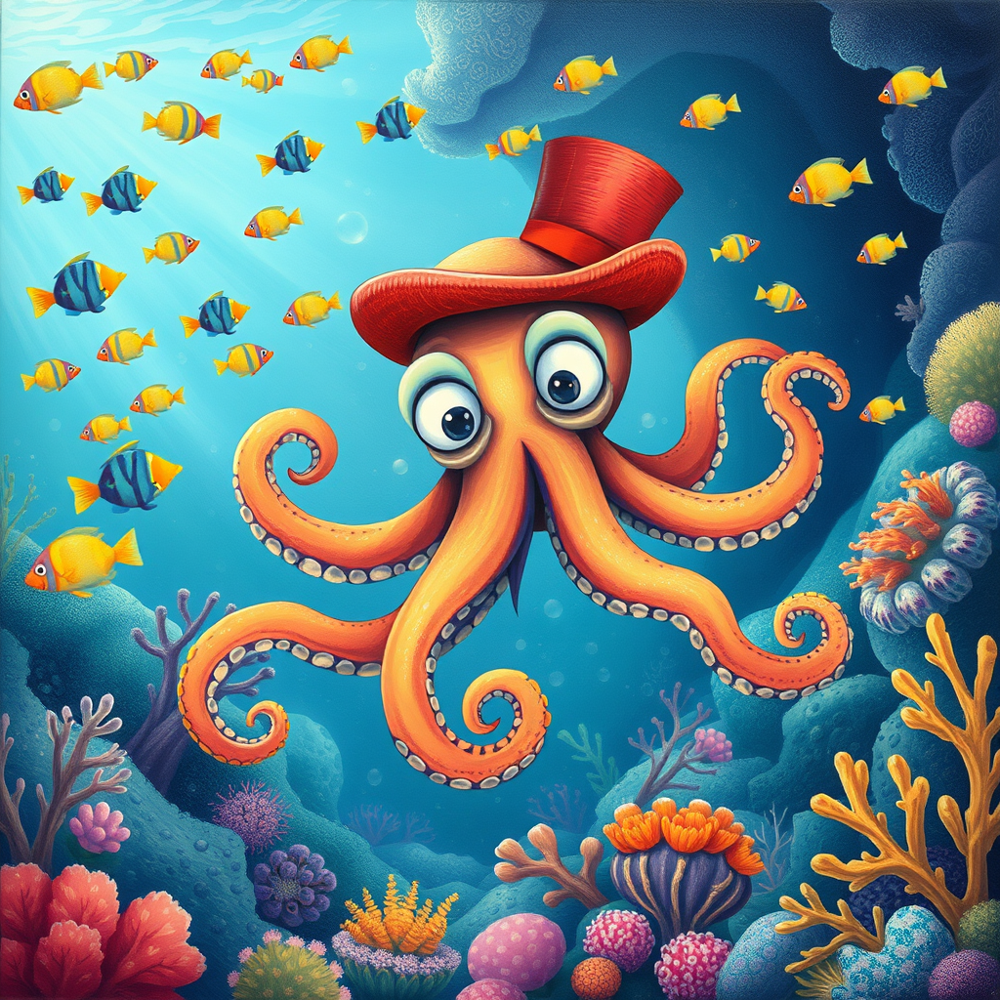

### Prompt: "A post-apocalyptic landscape with crumbling buildings, overgrown vegetation, and a lone figure walking towards the horizon."

Inferencing Time: 2.62s


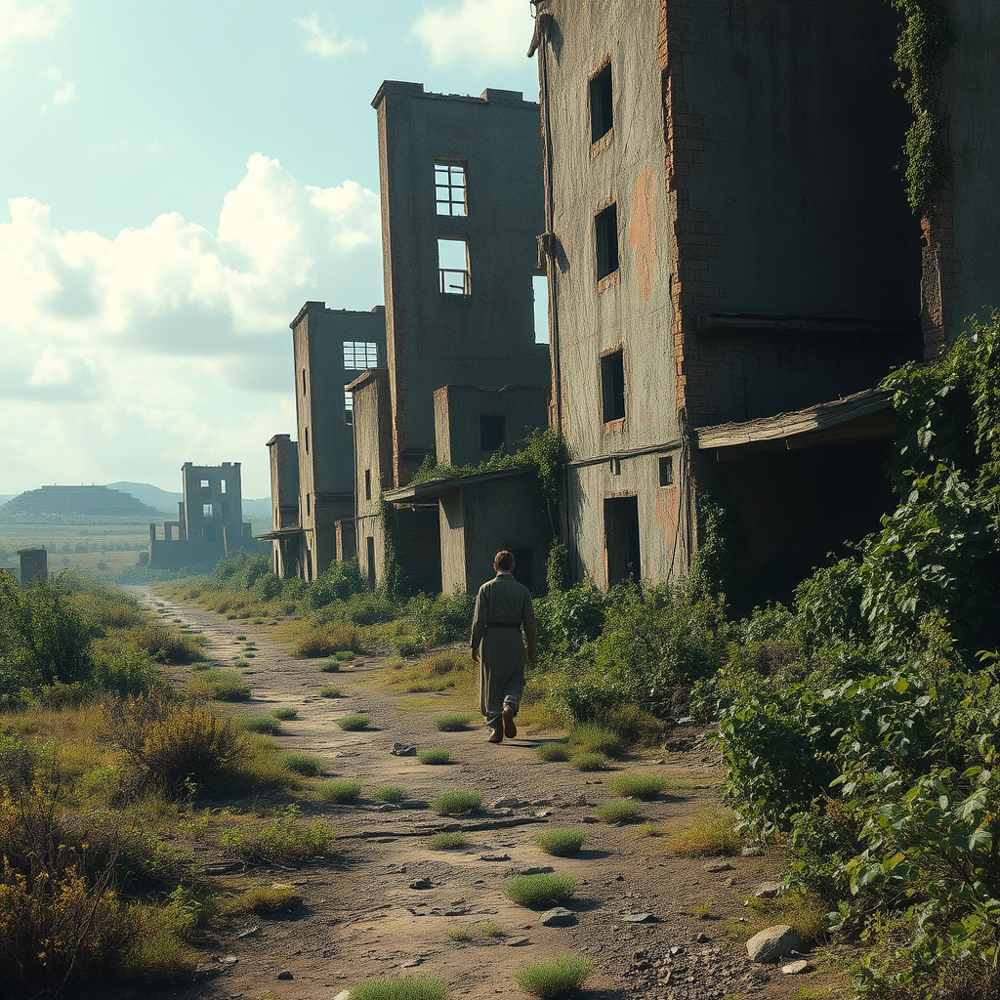

In [50]:
for prompt in prompts:
    body = {
        'prompt': prompt,
        'inference_steps': 4,
        'guidance_scale': 0.0
    }
    headers = {'Content-Type':'application/json', 'Authorization':('Bearer '+ api_key)}
    start = time.time()
    response = requests.post(scoring_uri, data=json.dumps(body), headers=headers)
    stop = time.time()
    display(Markdown(f'### Prompt: "{prompt}"'))
    display(Markdown(f'Inferencing Time: {str(round(stop-start,2))}s'))
    b64_img = response.json()['image_base64']
    html_image = f'<img src="data:image/png;base64,{b64_img}" style="height:500px; width:auto;"/>'
    display(HTML(html_image))
    
    